<div style='color: #216969;
           background-color: #EAF6F6;
           font-size: 200%;
           border-radius:15px;
           text-align:center;
           font-weight:600;
           border-style: solid;
           border-color: dark green;
           font-family: "Cambria";'>
PREDICTING EMPLOYEE PROMOTION 
<a class="anchor" id="1"></a> 


# INTRODUCTION 
There are many advantages that comes with promotion in the workplace. It comes with increase in prestige, respect and wages/salary. Promotion in a business environment also comes with increase freedom and agency. It is because of this that many employees at different levels in an organisation tries to climb the corporate ladder in order to enjoy the various advantages that comes with it.

Organisations also pay much attention to who is going to get promoted and how that will affect the business. This is because the activities of those in key positions in a business usually affects the welfare of the organisation in general. Firm and businesses pay attention to many factors when making decision on who to promote. For this reason resources are expended by businesses in the process of selection of employee to promote. Employees in organizations also make effort to signal to their employers that they are the best fit for promotion. This involves on working to improve various factors that can lead them to be viable for promotion.



This project is important for both employers looking to start training in arears to promotion of employees. It is also important to employees to determine their strength and weaknesses, oppurtunities and threts, as well as, key factors to work on in order to get promoted.  Although this is a case study of a given firm, the findings of this study can be applied to various firms.

# RESEARCH QUESTIONS

**1.What are the most important features and the influence these features have in predicting employee promotion with a particular row of data?**

**2. Which features are the strongest in predicting employee promotion?**

**3. Does the contribution of each feature vary by gender?**

In [1]:
#importing libraries
import numpy as np #for linear algebra
import pandas as pd #for data manipulation

 #for data visualization
import plotly.express as px
import plotly.graph_objects as  go
import seaborn as sns
import matplotlib.pyplot as plt

plt.rcParams['figure.figsize'] = (18, 8)

#Model
import imblearn
import sklearn
import shap  # package used to calculate Shap values


import time
import warnings
warnings.filterwarnings('ignore')

# ABOUT THE DATA


Let's import our dataset using pandas.

In [2]:
#import the csv files using pandas
train= pd.read_csv('train.csv')
test= pd.read_csv('test.csv')
train

,employee_id,department,region,education,gender,recruitment_channel,no_of_trainings,age,previous_year_rating,length_of_service,KPIs_met >80%,awards_won?,avg_training_score,is_promoted
0,65438,Sales & Marketing,region_7,Master's & above,f,sourcing,1,35,5.0,8,1,0,49,0
1,65141,Operations,region_22,Bachelor's,m,other,1,30,5.0,4,0,0,60,0
2,7513,Sales & Marketing,region_19,Bachelor's,m,sourcing,1,34,3.0,7,0,0,50,0
3,2542,Sales & Marketing,region_23,Bachelor's,m,other,2,39,1.0,10,0,0,50,0
4,48945,Technology,region_26,Bachelor's,m,other,1,45,3.0,2,0,0,73,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
54803,3030,Technology,region_14,Bachelor's,m,sourcing,1,48,3.0,17,0,0,78,0
54804,74592,Operations,region_27,Master's & above,f,other,1,37,2.0,6,0,0,56,0
54805,13918,Analytics,region_1,Bachelor's,m,other,1,27,5.0,3,1,0,79,0
54806,13614,Sales & Marketing,region_9,NaN,m,sourcing,1,29,1.0,2,0,0,45,0


A large MNC have 9 broad verticals across the organisation. One of the problem is identifying the right people for promotion (only for manager position and below) and prepare them in time.

The final promotions are only announced after the evaluation and this leads to delay in transition to new roles. Hence, company needs help in identifying the eligible candidates at a particular checkpoint so that they can expedite the entire promotion cycle.


Note: Details on the dataset used in this analysis can be found [Here](http://www.kaggle.com/datasets/arashnic/hr-ana)

In [3]:
#the shape of the dataset
print('the shape of train data',train.shape)
print('the shape of test data', test.shape)


the shape of train data (54808, 14)
the shape of test data (23490, 13)


In [4]:
#columns in the train data
train.columns

Index(['employee_id', 'department', 'region', 'education', 'gender',
       'recruitment_channel', 'no_of_trainings', 'age', 'previous_year_rating',
       'length_of_service', 'KPIs_met >80%', 'awards_won?',
       'avg_training_score', 'is_promoted'],
      dtype='object')

In [5]:
#columns in test data
test.columns

Index(['employee_id', 'department', 'region', 'education', 'gender',
       'recruitment_channel', 'no_of_trainings', 'age', 'previous_year_rating',
       'length_of_service', 'KPIs_met >80%', 'awards_won?',
       'avg_training_score'],
      dtype='object')

* `employee_id`: Unique ID for employee.

* `department`: Department of employee.

* `region`: Region of employment (unordered).

* `education`: Education Level.

* `gender`: Gender of Employee.

* `recruitment_channel`: Channel of recruitment for employee.

* `no_of_trainings`: no of other trainings completed in previous year on soft skills, technical skills etc.

* `age`: Age of Employee

* `previous_ year_rating`: Employee Rating for the previous year.

* `length_ of_ service`: Length of service in years.

* `awards_ won?`: if awards won during previous year then 1 else 0.

* `avg_ training_ score`: Average score in current training evaluations.

* `is_promoted`: (Target) Recommended for promotion.

The columns in the test and train data are the same except that `is_promoted` is not included in the test data.

# EXPLORATORY DATA ANALYSIS

## STRUCTURE INVESTIGATION

In [6]:
#check the first few columns of the dataset
train.head()

,employee_id,department,region,education,gender,recruitment_channel,no_of_trainings,age,previous_year_rating,length_of_service,KPIs_met >80%,awards_won?,avg_training_score,is_promoted
0,65438,Sales & Marketing,region_7,Master's & above,f,sourcing,1,35,5.0,8,1,0,49,0
1,65141,Operations,region_22,Bachelor's,m,other,1,30,5.0,4,0,0,60,0
2,7513,Sales & Marketing,region_19,Bachelor's,m,sourcing,1,34,3.0,7,0,0,50,0
3,2542,Sales & Marketing,region_23,Bachelor's,m,other,2,39,1.0,10,0,0,50,0
4,48945,Technology,region_26,Bachelor's,m,other,1,45,3.0,2,0,0,73,0


In [7]:
#descriptive statistics for numerical columns
train.describe()

,employee_id,no_of_trainings,age,previous_year_rating,length_of_service,KPIs_met >80%,awards_won?,avg_training_score,is_promoted
count,54808.000000,54808.000000,54808.000000,50684.000000,54808.000000,54808.000000,54808.000000,54808.000000,54808.000000
mean,39195.830627,1.253011,34.803915,3.329256,5.865512,0.351974,0.023172,63.386750,0.085170
std,22586.581449,0.609264,7.660169,1.259993,4.265094,0.477590,0.150450,13.371559,0.279137
min,1.000000,1.000000,20.000000,1.000000,1.000000,0.000000,0.000000,39.000000,0.000000
25%,19669.750000,1.000000,29.000000,3.000000,3.000000,0.000000,0.000000,51.000000,0.000000
50%,39225.500000,1.000000,33.000000,3.000000,5.000000,0.000000,0.000000,60.000000,0.000000
75%,58730.500000,1.000000,39.000000,4.000000,7.000000,1.000000,0.000000,76.000000,0.000000
max,78298.000000,10.000000,60.000000,5.000000,37.000000,1.000000,1.000000,99.000000,1.000000


In [8]:
#descriptive statististics for categorical columns
train.describe(include = 'object')

,department,region,education,gender,recruitment_channel
count,54808,54808,52399,54808,54808
unique,9,34,3,2,3
top,Sales & Marketing,region_2,Bachelor's,m,other
freq,16840,12343,36669,38496,30446


In [9]:
#value counts of the target variable
train.is_promoted.value_counts()

0    50140
1     4668
Name: is_promoted, dtype: int64

In [10]:
#What is rhe count of data types in the dataset
pd.value_counts(train.dtypes)

int64      8
object     5
float64    1
dtype: int64

In [11]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 54808 entries, 0 to 54807
Data columns (total 14 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   employee_id           54808 non-null  int64  
 1   department            54808 non-null  object 
 2   region                54808 non-null  object 
 3   education             52399 non-null  object 
 4   gender                54808 non-null  object 
 5   recruitment_channel   54808 non-null  object 
 6   no_of_trainings       54808 non-null  int64  
 7   age                   54808 non-null  int64  
 8   previous_year_rating  50684 non-null  float64
 9   length_of_service     54808 non-null  int64  
 10  KPIs_met >80%         54808 non-null  int64  
 11  awards_won?           54808 non-null  int64  
 12  avg_training_score    54808 non-null  int64  
 13  is_promoted           54808 non-null  int64  
dtypes: float64(1), int64(8), object(5)
memory usage: 5.9+ MB


In [12]:
#Number of Unique Values
unique_values= train.select_dtypes(include='number').nunique()

fig = px.bar(unique_values, title='Number of Unique Values', labels = {'x':'', 'y':'Features'}, log_y=True)
fig.update_xaxes(categoryorder='total descending')
fig.update_layout(showlegend=False)

`employee_id' has the highest amount of unique values in the datset as it is a unique id for each employee. 

## QUALITY INVESTIGATION

### DUPLICATES
Duplicates are entries that represents the same sample points on multiple rows.

In [13]:
#Check Number of Duplicates
n_duplicates = train.duplicated().sum()
print(f'We have {n_duplicates} duplicates in our dataset')

We have 0 duplicates in our dataset


### MISSING VALUES

### PER SAMPLE

In [14]:
px.imshow(train.isna(),title='Rows with Missing Values',labels={'x': 'Features', 'y': 'Rows'})

It can be seen that only two  columns contains missing values. The `education` column and the `previous_year_rating`. This can be indicative of non-random missing value. To deal with the missing value, we first check if we can discover a pattern in the missing value. If so, we deal with the missing value with business logic else we impute the central tendency values (mean for continuous columns and mode for categorical column.

To begin our investigation, let's start by checking the perecentage of missing values in the dataset.

### PER FEATURE

In [15]:

#total missing data
train_total = train.isnull().sum()
test_total = test.isnull().sum()
#percentage of missing values
train_percent= ((train.isnull().sum()/train.shape[0])*100)
test_percent= ((test.isnull().sum()/test.shape[0])*100)

'''
Create a dataframe to show total number of missing values 
and percentage of missing values in both training and test data
'''
data_missing= pd.DataFrame({'train total':train_total, 'train percent': train_percent,'test total': test_total, 'test percent': test_percent})
data_missing.sort_values(by='train total', ascending=False).head()

,train total,train percent,test total,test percent
previous_year_rating,4124,7.524449,1812.0,7.713921
education,2409,4.395344,1034.0,4.401873
KPIs_met >80%,0,0.000000,0.0,0.000000
age,0,0.000000,0.0,0.000000
avg_training_score,0,0.000000,0.0,0.000000


### INVESTIGATING THE CAUSE OF THE MISSING VALUE

In [16]:
#check the rows with null values to discover if the missing values have any pattern
train[train['previous_year_rating'].isnull()]

,employee_id,department,region,education,gender,recruitment_channel,no_of_trainings,age,previous_year_rating,length_of_service,KPIs_met >80%,awards_won?,avg_training_score,is_promoted
10,29934,Technology,region_23,NaN,m,sourcing,1,30,NaN,1,0,0,77,0
23,71177,Procurement,region_5,Bachelor's,m,other,1,27,NaN,1,0,0,70,0
29,74759,Sales & Marketing,region_4,Bachelor's,m,sourcing,1,26,NaN,1,0,0,44,0
56,45709,Sales & Marketing,region_31,Bachelor's,f,other,1,29,NaN,1,0,0,49,0
58,26599,Sales & Marketing,region_16,Bachelor's,m,other,2,27,NaN,1,1,0,47,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
54703,74615,R&D,region_31,Bachelor's,m,sourcing,1,30,NaN,1,1,0,88,0
54734,11685,Operations,region_15,Bachelor's,m,sourcing,1,31,NaN,1,1,0,56,1
54746,10546,Finance,region_6,Bachelor's,m,other,1,28,NaN,1,1,0,61,0
54773,37919,Finance,region_2,Bachelor's,m,other,1,23,NaN,1,1,0,61,0


From the output above, one can see that almost all the rows with missing values for `previous_year_rating` have a `length of service`=1.


In [17]:
train.query('length_of_service==1 & previous_year_rating.isnull()', engine='python')

,employee_id,department,region,education,gender,recruitment_channel,no_of_trainings,age,previous_year_rating,length_of_service,KPIs_met >80%,awards_won?,avg_training_score,is_promoted
10,29934,Technology,region_23,NaN,m,sourcing,1,30,NaN,1,0,0,77,0
23,71177,Procurement,region_5,Bachelor's,m,other,1,27,NaN,1,0,0,70,0
29,74759,Sales & Marketing,region_4,Bachelor's,m,sourcing,1,26,NaN,1,0,0,44,0
56,45709,Sales & Marketing,region_31,Bachelor's,f,other,1,29,NaN,1,0,0,49,0
58,26599,Sales & Marketing,region_16,Bachelor's,m,other,2,27,NaN,1,1,0,47,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
54703,74615,R&D,region_31,Bachelor's,m,sourcing,1,30,NaN,1,1,0,88,0
54734,11685,Operations,region_15,Bachelor's,m,sourcing,1,31,NaN,1,1,0,56,1
54746,10546,Finance,region_6,Bachelor's,m,other,1,28,NaN,1,1,0,61,0
54773,37919,Finance,region_2,Bachelor's,m,other,1,23,NaN,1,1,0,61,0


In [18]:
#testing the hypothesis

hypothesis = train.query('length_of_service != 1')['previous_year_rating'].isna().any()

print(f' Is there any row with null values for previous_year_rating column and 1 for length_of_service?   {hypothesis}')

 Is there any row with null values for previous_year_rating column and 1 for length_of_service?   False


This can be interpreted to mean that workers with only 1 year of service to the firm have misssing values for `previous_year_rating`
because they were not part of the firm in the previous year.

In [19]:
#Checking for pattern for missing values in 'education' column
train[train['education'].isnull()]

,employee_id,department,region,education,gender,recruitment_channel,no_of_trainings,age,previous_year_rating,length_of_service,KPIs_met >80%,awards_won?,avg_training_score,is_promoted
10,29934,Technology,region_23,NaN,m,sourcing,1,30,NaN,1,0,0,77,0
21,33332,Operations,region_15,NaN,m,sourcing,1,41,4.0,11,0,0,57,0
32,35465,Sales & Marketing,region_7,NaN,f,sourcing,1,24,1.0,2,0,0,48,0
43,17423,Sales & Marketing,region_2,NaN,m,other,3,24,2.0,2,0,0,48,0
82,66013,Sales & Marketing,region_2,NaN,m,sourcing,2,25,3.0,2,0,0,53,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
54692,14821,Sales & Marketing,region_2,NaN,f,sourcing,1,35,3.0,7,0,0,53,0
54717,7684,Analytics,region_2,NaN,m,sourcing,1,32,3.0,4,0,0,86,0
54729,1797,HR,region_2,NaN,f,other,1,28,3.0,2,0,0,53,0
54742,38935,Sales & Marketing,region_31,NaN,m,other,1,28,4.0,3,0,0,47,0


No pattern can be found for the missing value in the `education` column.

### DEALING WITH THE MISSING VALUES

In [20]:
'''
Impute missing values.
Mode values are imputed in missing education values because this is an ordinal variable.
0 will be imputed in place of the missing values in previous_year_rating.
'''

#fill the missing values in education
train['education']=train['education'].fillna(train.education.mode()[0])
test['education']=test['education'].fillna(test.education.mode()[0])

#fill the missing values in previous_year_rating
train['previous_year_rating']=train['previous_year_rating'].fillna(0)
test['previous_year_rating']=test['previous_year_rating'].fillna(0)

In [21]:
#check if the null values are still present
print('Number of missing values in the training dataset', train.isnull().sum().sum())
print('Number of missing values in the test dataset', test.isnull().sum().sum())

Number of missing values in the training dataset 0
Number of missing values in the test dataset 0


## OUTLIERS

In [22]:
#Since outliers are only posssible in numerical data, let's analyze the numerical columns
train.select_dtypes('number').columns.to_list()

['employee_id',
 'no_of_trainings',
 'age',
 'previous_year_rating',
 'length_of_service',
 'KPIs_met >80%',
 'awards_won?',
 'avg_training_score',
 'is_promoted']

An outlier can only exists in the `avg_training score` and `length_of_service` columns. As other variables have a limited number of  values.

In [23]:
fig=px.box(train,y='avg_training_score',points='outliers', title='Outliers in Average Training Score')

fig.update_layout(hovermode='x')

There is no outlier in the `avg_training_score` column.

In [24]:
fig=px.box(train,y='length_of_service', points='outliers', title='Outliers in Length of Service Column')

fig.update_layout(hovermode='x')

There are some points above the upper_fence (0.75 quantile) `length_of_service` value(13). Those are the outlier values. We cap the  outliers to the maximum value.

In [25]:
train['length_of_service']=np.where( train['length_of_service']>13,13, train['length_of_service'])
train['length_of_service'].max()

13

## CONTENT INVESTIGATION

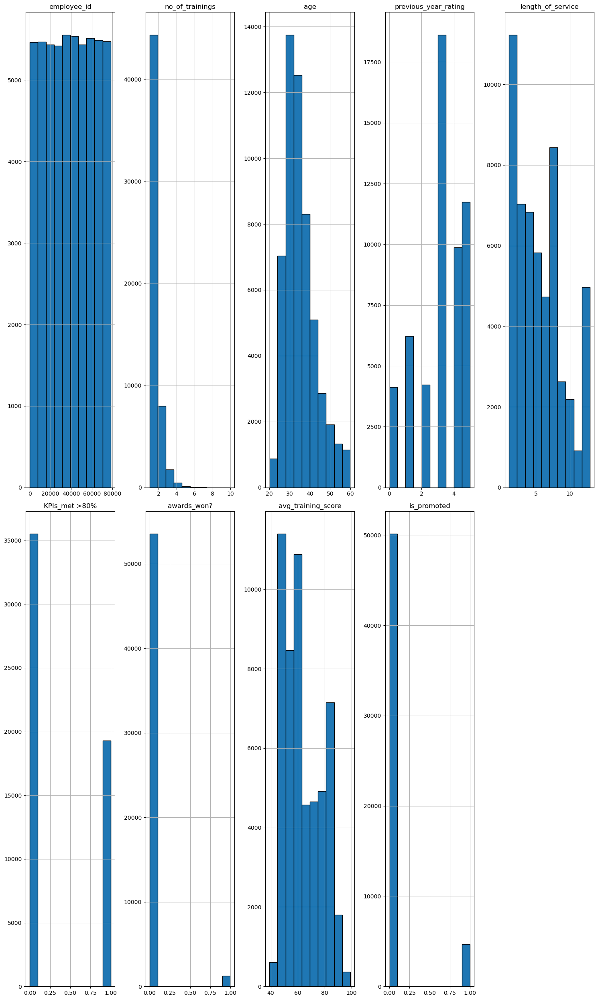

In [26]:
train.hist(bins=10, figsize=(15,25), layout=(-1, 5), edgecolor='black')
plt.tight_layout();

In [27]:
px.histogram(train,'is_promoted',facet_col='gender', color='is_promoted', marginal='rug')

Although only few employees are promoted, more males are promoted than females. This could be because the females are underrepresented in the dataset (there  are fewer females than males).

In [28]:
px.box( train,'recruitment_channel','length_of_service', color='recruitment_channel')

In [29]:
px.histogram(train, 'age',color='education', facet_col='education', barmode='group')

The age of employees with below secondary education are skewed to low values. That is, younger employees are

In [30]:
px.sunburst(train,path=[ 'gender','recruitment_channel'], values='no_of_trainings')

The sunburst chart shows that there are more males than females in the firm (as mentioned earlier) and the most of the males were recruited through other channels. From the rest of the males, most were sourced y the company while a very low percentage of them were refferred. the same relationship holds for the female employees.

In [31]:
px.strip(train, 'length_of_service','age')

The strip plot shows that as  `length_of_service` increase the spread of `age` also increases but they generally have a positive relationship. That is, employees who have worked with the firm for higher number of years are older. This makes sense as the younger employees are have less years to have invested in the firm.

## FEATURE RELATIONSHIP

In [32]:
px.imshow(train.corr(), text_auto= True, title='Correlation Between the Variables in the Model', height=1000)

# FEATURE ENGINEERING

Feature engineering involves the creation of new columns from raw data.The `awards_won?` and `previous_year_rating` columns are both performance/productivity metrics. Therefore, we create a new `sum_metric` columnby summing the two columns.

We also create a `total score` column which is the product of the `avg_training_score` and  the `no_of_trainings` column. 

In [33]:
#Creating a sum metric column
train['sum_metric'] = train['awards_won?']+ train['previous_year_rating']
test['sum_metric'] = test['awards_won?'] + test['previous_year_rating']

# creating a total score column
train['total_score'] = train['avg_training_score'] * train['no_of_trainings']
test['total_score'] = test['avg_training_score'] * test['no_of_trainings']


Let's drop the unneccessary columns

In [34]:
#Remove uneccessary features
train = train.drop(['region', 'employee_id'], axis = 1)
test = test.drop([ 'region', 'employee_id'], axis = 1)

# lets check the columns in train and test data set after feature engineering
train.columns

Index(['department', 'education', 'gender', 'recruitment_channel',
       'no_of_trainings', 'age', 'previous_year_rating', 'length_of_service',
       'KPIs_met >80%', 'awards_won?', 'avg_training_score', 'is_promoted',
       'sum_metric', 'total_score'],
      dtype='object')

In [35]:
train.length_of_service.head()

0     8
1     4
2     7
3    10
4     2
Name: length_of_service, dtype: int64

## Label Encoding

In [36]:
train.select_dtypes('object').head()

,department,education,gender,recruitment_channel
0,Sales & Marketing,Master's & above,f,sourcing
1,Operations,Bachelor's,m,other
2,Sales & Marketing,Bachelor's,m,sourcing
3,Sales & Marketing,Bachelor's,m,other
4,Technology,Bachelor's,m,other


In [37]:
train.education.value_counts()

Bachelor's          39078
Master's & above    14925
Below Secondary       805
Name: education, dtype: int64

In [38]:
#education is an ordinal variable
train['education']=train['education'].replace(("Master's & above", "Bachelor's", "Below Secondary"),(3,2,1))
test['education']=test['education'].replace(("Master's & above", "Bachelor's", "Below Secondary"),(3,2,1))

In [39]:
from sklearn.preprocessing import LabelEncoder
le=LabelEncoder()
train['department']=le.fit_transform(train['department'])
test['department']=le.fit_transform(test['department'])
train['gender']=le.fit_transform(train['gender'])
test['gender']=le.fit_transform(test['gender'])
train['recruitment_channel']=le.fit_transform(train['recruitment_channel'])
test['recruitment_channel']=le.fit_transform(test['recruitment_channel'])


print(train.select_dtypes('object').columns)
print(test.select_dtypes('object').columns)

Index([], dtype='object')
Index([], dtype='object')


In [40]:
#Check to see if the colums were actually changed
train.head()

,department,education,gender,recruitment_channel,no_of_trainings,age,previous_year_rating,length_of_service,KPIs_met >80%,awards_won?,avg_training_score,is_promoted,sum_metric,total_score
0,7,3,0,2,1,35,5.0,8,1,0,49,0,5.0,49
1,4,2,1,0,1,30,5.0,4,0,0,60,0,5.0,60
2,7,2,1,2,1,34,3.0,7,0,0,50,0,3.0,50
3,7,2,1,0,2,39,1.0,10,0,0,50,0,1.0,100
4,8,2,1,0,1,45,3.0,2,0,0,73,0,3.0,73


In [41]:
#split target from features

y=train['is_promoted']
x=train.drop(['is_promoted'],axis=1)
x_test=test

# CLASS BALANCE

In [42]:
px.histogram(train,x='is_promoted', color='is_promoted', title='Distribution of Target Variable')

`is_promoted` is the target column. It can be seen that it is imbalanced. That is, the 0 values are more than the 1 values. This can lead to bias in the model. To correct this, we use RandomOverSampler which has the advantage of increasing the amount of samples trained by the model.

In [43]:
#Resample the target 
from imblearn.over_sampling import RandomOverSampler

x_resample, y_resample = RandomOverSampler(sampling_strategy=1).fit_resample(x,y.values.ravel()) 


print(x_resample.shape)
print(y_resample.shape)

(100280, 13)
(100280,)


In [44]:
#Check if the data is balanced
px.histogram(y_resample, x=0, color=0, title='Distribution of Target After Resampling')

As seen in the bar graph above, our target is now balanced.

In [45]:
#Compare value counts of target before and after resampling
print("Before Resampling:")
print(y.value_counts())

print("After Resampling:")
y_resample = pd.DataFrame(y_resample)
print(y_resample.value_counts())

Before Resampling:
0    50140
1     4668
Name: is_promoted, dtype: int64
After Resampling:
0    50140
1    50140
dtype: int64


The original dataset has 50140 not promoted entries (0) and 4668 promoted (1) entries. The random oversampling  

In [46]:
#Create validation set
from sklearn.model_selection import train_test_split

x_train, x_valid, y_train, y_valid = train_test_split(x_resample, y_resample, test_size = 0.2, random_state = 0)

# lets print the shapes again 
print("Shape of the x Train :", x_train.shape)
print("Shape of the y Train :", y_train.shape)
print("Shape of the x Valid :", x_valid.shape)
print("Shape of the y Valid :", y_valid.shape)
print("Shape of the x Test :", x_test.shape)

Shape of the x Train : (80224, 13)
Shape of the y Train : (80224, 1)
Shape of the x Valid : (20056, 13)
Shape of the y Valid : (20056, 1)
Shape of the x Test : (23490, 13)


# MACHINE LEARNING MODEL
Random Forest will be employed for this analysis.A random forest is a model that averages the predictions of a large number
of decision trees, which are generated by randomly varying various parameters that
specify what data is used to train the tree and other tree parameters

In [47]:
from sklearn.model_selection import RandomizedSearchCV
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from xgboost import XGBClassifier
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_curve, roc_auc_score

Accuracy: 0.9787096130833666
Precision: 0.9596036585365854
Recall: 0.9997022332506204
F1 Score: 0.9792426231102036
ROC AUC Score: 0.9786107599476226


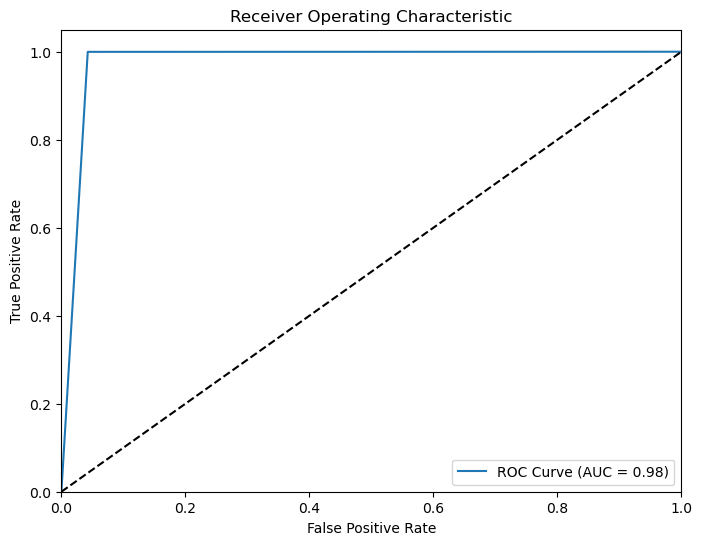

In [49]:
from sklearn.ensemble import RandomForestClassifier

model=RandomForestClassifier()

model.fit(x_train,y_train)

y_pred=model.predict(x_valid)
# Calculate performance metrics
accuracy = accuracy_score(y_valid, y_pred.round())
precision = precision_score(y_valid, y_pred.round())
recall = recall_score(y_valid, y_pred.round())
f1 = f1_score(y_valid, y_pred.round())
roc_auc = roc_auc_score(y_valid, y_pred)

# Print performance metrics
print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)
print("F1 Score:", f1)
print("ROC AUC Score:", roc_auc)

# Plot ROC curve
fpr, tpr, thresholds = roc_curve(y_valid, y_pred)
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, label='ROC Curve (AUC = %0.2f)' % roc_auc)
plt.plot([0, 1], [0, 1], 'k--')  # Plot the random guessing curve
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic')
plt.legend(loc='lower right')
plt.show()


# MODEL EVALUATION

In [50]:
from sklearn.metrics import confusion_matrix, classification_report

print("Training Accuracy :", model.score(x_train, y_train))
print("Testing Accuracy:", model.score(x_valid, y_valid))

cm = confusion_matrix(y_valid, y_pred)
fig = px.imshow(cm,text_auto=True, title='Confusion Matrix of the Model')
fig.update_layout(xaxis_title='Actual', yaxis_title='Predicted')

Training Accuracy : 0.9972950737933786
Testing Accuracy: 0.9787096130833666


The training data has 99% accuracy. That is, 99% of the entries in the training data were correctly predicted. Although this is a high value, the suspicion of overfitting can be ignored as the accuracy score for the test data is also high
The test data, on the other hand, has an accuracy score of 98%. That is,  98% of the entries in the test data were correctly predicted.


The training data has 99% accuracy. That is, 99% of the entries in the training data were correctly predicted. 
The test data, on the other hand, has an accuracy score of 98%. That is,  98% of the entries in the test data were correctly predicted.

The classification matrix shows that:
* 9495 unpromoted target (1)were correctly predicted
* 10000 of the promoted target (0) were correctly predicted. 
* 10 of the unpromoted entries were misclassified as promoted.
* 1226 of the promoted entries were misclassified as unpromoted.

In [53]:
cr=classification_report(y_valid, y_pred)
print(cr)

              precision    recall  f1-score   support

           0       1.00      0.96      0.98      9981
           1       0.96      1.00      0.98     10075

    accuracy                           0.98     20056
   macro avg       0.98      0.98      0.98     20056
weighted avg       0.98      0.98      0.98     20056



[05:45:03] WARNING: C:\Windows\Temp\abs_557yfx631l\croots\recipe\xgboost-split_1659548953302\work\src\learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Accuracy: 0.8761966493817311
Precision: 0.8264533883728931
Recall: 0.9538461538461539
F1 Score: 0.8855918536607843
ROC AUC Score: 0.8758310019806865


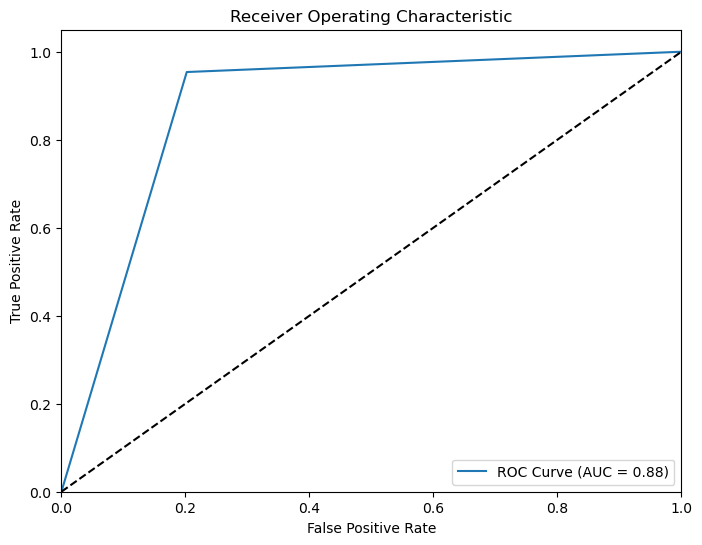

In [54]:
from xgboost import XGBClassifier

XGB = XGBClassifier()

XGB.fit(x_train,y_train)

y_pred = XGB.predict(x_valid)
# Calculate performance metrics
accuracy = accuracy_score(y_valid, y_pred.round())
precision = precision_score(y_valid, y_pred.round())
recall = recall_score(y_valid, y_pred.round())
f1 = f1_score(y_valid, y_pred.round())
roc_auc = roc_auc_score(y_valid, y_pred)

# Print performance metrics
print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)
print("F1 Score:", f1)
print("ROC AUC Score:", roc_auc)

# Plot ROC curve
fpr, tpr, thresholds = roc_curve(y_valid, y_pred)
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, label='ROC Curve (AUC = %0.2f)' % roc_auc)
plt.plot([0, 1], [0, 1], 'k--')  # Plot the random guessing curve
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic')
plt.legend(loc='lower right')
plt.show()


In [55]:
from sklearn.metrics import confusion_matrix, classification_report

print("Training Accuracy :", XGB.score(x_train, y_train))
print("Testing Accuracy:", XGB.score(x_valid, y_valid))

cm = confusion_matrix(y_valid, y_pred)
fig = px.imshow(cm,text_auto=True, title='Confusion Matrix of the Model')
fig.update_layout(xaxis_title='Actual', yaxis_title='Predicted')

Training Accuracy : 0.8899581172716394
Testing Accuracy: 0.8761966493817311


Accuracy: 0.8469285999202234
Precision: 0.7854290603862766
Recall: 0.9566253101736972
F1 Score: 0.8626152331513469
ROC AUC Score: 0.9309427614701182


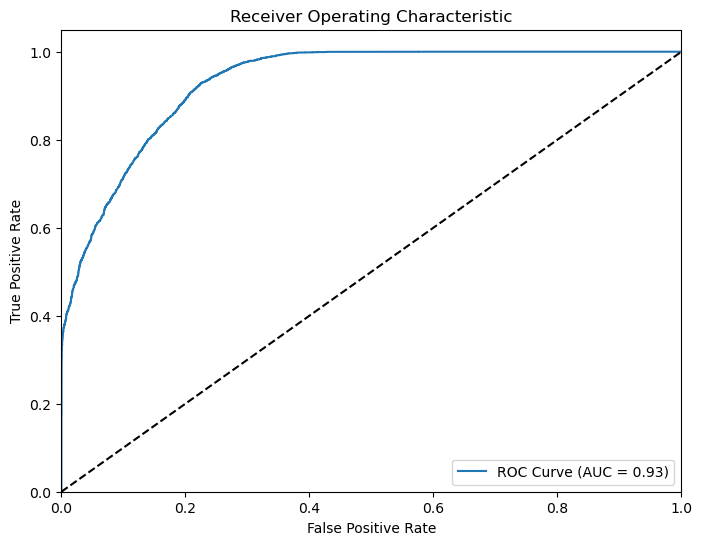

In [56]:
import matplotlib.pyplot as plt
from lightgbm import LGBMClassifier
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_curve, roc_auc_score

LGB = LGBMClassifier()
LGB.fit(x_train, y_train)
y_pred = LGB.predict_proba(x_valid)[:, 1]

# Calculate performance metrics
accuracy = accuracy_score(y_valid, y_pred.round())
precision = precision_score(y_valid, y_pred.round())
recall = recall_score(y_valid, y_pred.round())
f1 = f1_score(y_valid, y_pred.round())
roc_auc = roc_auc_score(y_valid, y_pred)

# Print performance metrics
print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)
print("F1 Score:", f1)
print("ROC AUC Score:", roc_auc)

# Plot ROC curve
fpr, tpr, thresholds = roc_curve(y_valid, y_pred)
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, label='ROC Curve (AUC = %0.2f)' % roc_auc)
plt.plot([0, 1], [0, 1], 'k--')  # Plot the random guessing curve
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic')
plt.legend(loc='lower right')
plt.show()


Learning rate set to 0.067
0:	learn: 0.6557618	total: 192ms	remaining: 3m 11s
1:	learn: 0.6202105	total: 212ms	remaining: 1m 45s
2:	learn: 0.5936811	total: 229ms	remaining: 1m 16s
3:	learn: 0.5642220	total: 243ms	remaining: 1m
4:	learn: 0.5373669	total: 256ms	remaining: 50.9s
5:	learn: 0.5159397	total: 272ms	remaining: 45s
6:	learn: 0.5019237	total: 286ms	remaining: 40.6s
7:	learn: 0.4926509	total: 300ms	remaining: 37.2s
8:	learn: 0.4814310	total: 313ms	remaining: 34.5s
9:	learn: 0.4742932	total: 327ms	remaining: 32.3s
10:	learn: 0.4679918	total: 339ms	remaining: 30.5s
11:	learn: 0.4625981	total: 352ms	remaining: 29s
12:	learn: 0.4549635	total: 365ms	remaining: 27.7s
13:	learn: 0.4519520	total: 379ms	remaining: 26.7s
14:	learn: 0.4391909	total: 392ms	remaining: 25.7s
15:	learn: 0.4341618	total: 404ms	remaining: 24.9s
16:	learn: 0.4301436	total: 418ms	remaining: 24.2s
17:	learn: 0.4243392	total: 436ms	remaining: 23.8s
18:	learn: 0.4223449	total: 448ms	remaining: 23.1s
19:	learn: 0.41779

169:	learn: 0.3329984	total: 2.73s	remaining: 13.3s
170:	learn: 0.3328239	total: 2.75s	remaining: 13.3s
171:	learn: 0.3327630	total: 2.76s	remaining: 13.3s
172:	learn: 0.3322721	total: 2.79s	remaining: 13.3s
173:	learn: 0.3320185	total: 2.81s	remaining: 13.3s
174:	learn: 0.3318781	total: 2.83s	remaining: 13.3s
175:	learn: 0.3317645	total: 2.85s	remaining: 13.3s
176:	learn: 0.3312064	total: 2.87s	remaining: 13.3s
177:	learn: 0.3310339	total: 2.89s	remaining: 13.3s
178:	learn: 0.3308123	total: 2.9s	remaining: 13.3s
179:	learn: 0.3307037	total: 2.92s	remaining: 13.3s
180:	learn: 0.3306141	total: 2.93s	remaining: 13.3s
181:	learn: 0.3304145	total: 2.95s	remaining: 13.2s
182:	learn: 0.3301895	total: 2.96s	remaining: 13.2s
183:	learn: 0.3300832	total: 2.98s	remaining: 13.2s
184:	learn: 0.3299023	total: 2.99s	remaining: 13.2s
185:	learn: 0.3297043	total: 3s	remaining: 13.1s
186:	learn: 0.3296517	total: 3.02s	remaining: 13.1s
187:	learn: 0.3295019	total: 3.03s	remaining: 13.1s
188:	learn: 0.32

328:	learn: 0.3078086	total: 5.09s	remaining: 10.4s
329:	learn: 0.3077184	total: 5.11s	remaining: 10.4s
330:	learn: 0.3076520	total: 5.12s	remaining: 10.3s
331:	learn: 0.3075296	total: 5.13s	remaining: 10.3s
332:	learn: 0.3070934	total: 5.15s	remaining: 10.3s
333:	learn: 0.3070220	total: 5.17s	remaining: 10.3s
334:	learn: 0.3069061	total: 5.18s	remaining: 10.3s
335:	learn: 0.3068145	total: 5.19s	remaining: 10.3s
336:	learn: 0.3067360	total: 5.21s	remaining: 10.2s
337:	learn: 0.3065313	total: 5.22s	remaining: 10.2s
338:	learn: 0.3064065	total: 5.24s	remaining: 10.2s
339:	learn: 0.3062988	total: 5.25s	remaining: 10.2s
340:	learn: 0.3061848	total: 5.27s	remaining: 10.2s
341:	learn: 0.3060848	total: 5.28s	remaining: 10.2s
342:	learn: 0.3059106	total: 5.3s	remaining: 10.1s
343:	learn: 0.3057712	total: 5.31s	remaining: 10.1s
344:	learn: 0.3056442	total: 5.33s	remaining: 10.1s
345:	learn: 0.3055806	total: 5.34s	remaining: 10.1s
346:	learn: 0.3054649	total: 5.35s	remaining: 10.1s
347:	learn: 0

493:	learn: 0.2899425	total: 7.47s	remaining: 7.66s
494:	learn: 0.2898860	total: 7.49s	remaining: 7.64s
495:	learn: 0.2898002	total: 7.51s	remaining: 7.63s
496:	learn: 0.2896081	total: 7.52s	remaining: 7.61s
497:	learn: 0.2895178	total: 7.54s	remaining: 7.6s
498:	learn: 0.2894229	total: 7.55s	remaining: 7.58s
499:	learn: 0.2893459	total: 7.56s	remaining: 7.56s
500:	learn: 0.2892229	total: 7.58s	remaining: 7.55s
501:	learn: 0.2891350	total: 7.59s	remaining: 7.53s
502:	learn: 0.2890578	total: 7.6s	remaining: 7.51s
503:	learn: 0.2889295	total: 7.62s	remaining: 7.5s
504:	learn: 0.2888412	total: 7.63s	remaining: 7.48s
505:	learn: 0.2887722	total: 7.64s	remaining: 7.46s
506:	learn: 0.2886718	total: 7.66s	remaining: 7.45s
507:	learn: 0.2885344	total: 7.67s	remaining: 7.43s
508:	learn: 0.2883593	total: 7.69s	remaining: 7.42s
509:	learn: 0.2882465	total: 7.7s	remaining: 7.4s
510:	learn: 0.2881871	total: 7.72s	remaining: 7.38s
511:	learn: 0.2880431	total: 7.73s	remaining: 7.37s
512:	learn: 0.287

656:	learn: 0.2754208	total: 9.59s	remaining: 5.01s
657:	learn: 0.2753049	total: 9.61s	remaining: 4.99s
658:	learn: 0.2751661	total: 9.63s	remaining: 4.98s
659:	learn: 0.2751060	total: 9.64s	remaining: 4.96s
660:	learn: 0.2750359	total: 9.65s	remaining: 4.95s
661:	learn: 0.2749790	total: 9.66s	remaining: 4.93s
662:	learn: 0.2749365	total: 9.67s	remaining: 4.92s
663:	learn: 0.2748530	total: 9.69s	remaining: 4.9s
664:	learn: 0.2747828	total: 9.7s	remaining: 4.89s
665:	learn: 0.2747129	total: 9.71s	remaining: 4.87s
666:	learn: 0.2746634	total: 9.72s	remaining: 4.86s
667:	learn: 0.2745806	total: 9.74s	remaining: 4.84s
668:	learn: 0.2744697	total: 9.75s	remaining: 4.82s
669:	learn: 0.2743791	total: 9.76s	remaining: 4.81s
670:	learn: 0.2743350	total: 9.78s	remaining: 4.79s
671:	learn: 0.2742304	total: 9.79s	remaining: 4.78s
672:	learn: 0.2741079	total: 9.81s	remaining: 4.77s
673:	learn: 0.2740504	total: 9.82s	remaining: 4.75s
674:	learn: 0.2739823	total: 9.84s	remaining: 4.74s
675:	learn: 0.

825:	learn: 0.2624469	total: 12.4s	remaining: 2.61s
826:	learn: 0.2623863	total: 12.4s	remaining: 2.59s
827:	learn: 0.2622918	total: 12.4s	remaining: 2.58s
828:	learn: 0.2622229	total: 12.4s	remaining: 2.56s
829:	learn: 0.2621583	total: 12.4s	remaining: 2.55s
830:	learn: 0.2621194	total: 12.4s	remaining: 2.53s
831:	learn: 0.2620473	total: 12.5s	remaining: 2.52s
832:	learn: 0.2619453	total: 12.5s	remaining: 2.5s
833:	learn: 0.2618617	total: 12.5s	remaining: 2.48s
834:	learn: 0.2617807	total: 12.5s	remaining: 2.47s
835:	learn: 0.2617284	total: 12.5s	remaining: 2.45s
836:	learn: 0.2616225	total: 12.5s	remaining: 2.44s
837:	learn: 0.2615389	total: 12.5s	remaining: 2.42s
838:	learn: 0.2614955	total: 12.5s	remaining: 2.41s
839:	learn: 0.2614224	total: 12.6s	remaining: 2.39s
840:	learn: 0.2613346	total: 12.6s	remaining: 2.38s
841:	learn: 0.2612459	total: 12.6s	remaining: 2.36s
842:	learn: 0.2612114	total: 12.6s	remaining: 2.35s
843:	learn: 0.2611117	total: 12.6s	remaining: 2.33s
844:	learn: 0

996:	learn: 0.2514546	total: 14.7s	remaining: 44.3ms
997:	learn: 0.2513844	total: 14.7s	remaining: 29.6ms
998:	learn: 0.2513274	total: 14.8s	remaining: 14.8ms
999:	learn: 0.2512660	total: 14.8s	remaining: 0us
Accuracy: 0.875
Precision: 0.8216046234914159
Recall: 0.9595037220843673
F1 Score: 0.8852158783938465
ROC AUC Score: 0.8746020764514613


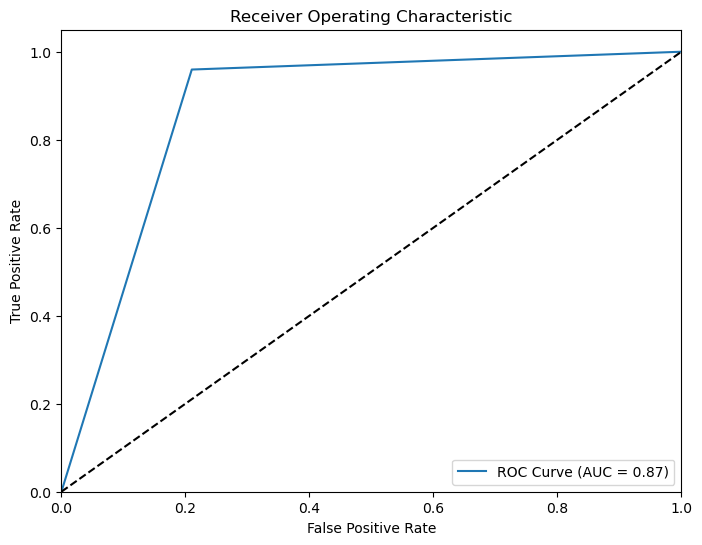

In [58]:
from catboost import CatBoostClassifier
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_curve, roc_auc_score

# Create CatBoost classifier instance
catboost_model = CatBoostClassifier()

# Fit the model to the training data
catboost_model.fit(x_train, y_train)

# Make predictions on the validation data
y_pred = catboost_model.predict(x_valid)

# Calculate performance metrics
accuracy = accuracy_score(y_valid, y_pred)
precision = precision_score(y_valid, y_pred)
recall = recall_score(y_valid, y_pred)
f1 = f1_score(y_valid, y_pred)
roc_auc = roc_auc_score(y_valid, y_pred)

# Print performance metrics
print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)
print("F1 Score:", f1)
print("ROC AUC Score:", roc_auc)

# Plot ROC curve
fpr, tpr, thresholds = roc_curve(y_valid, y_pred, pos_label=1)
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, label='ROC Curve (AUC = %0.2f)' % roc_auc)
plt.plot([0, 1], [0, 1], 'k--')  # Plot the random guessing curve
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic')
plt.legend(loc='lower right')
plt.show()


Epoch 1/100
2507/2507 [==============================] - 4s 1ms/step - loss: 0.4959 - accuracy: 0.7503
Epoch 2/100
2507/2507 [==============================] - 3s 1ms/step - loss: 0.4295 - accuracy: 0.7852
Epoch 3/100
2507/2507 [==============================] - 3s 1ms/step - loss: 0.3826 - accuracy: 0.8094
Epoch 4/100
2507/2507 [==============================] - 3s 1ms/step - loss: 0.3647 - accuracy: 0.8169
Epoch 5/100
2507/2507 [==============================] - 3s 1ms/step - loss: 0.3576 - accuracy: 0.8195
Epoch 6/100
2507/2507 [==============================] - 3s 1ms/step - loss: 0.3522 - accuracy: 0.8208
Epoch 7/100
2507/2507 [==============================] - 3s 1ms/step - loss: 0.3473 - accuracy: 0.8227
Epoch 8/100
2507/2507 [==============================] - 3s 1ms/step - loss: 0.3440 - accuracy: 0.8245
Epoch 9/100
2507/2507 [==============================] - 3s 1ms/step - loss: 0.3402 - accuracy: 0.8270
Epoch 10/100
2507/2507 [==============================] - 3s 1ms/step - l

2507/2507 [==============================] - 3s 1ms/step - loss: 0.2180 - accuracy: 0.9008
Epoch 80/100
2507/2507 [==============================] - 3s 1ms/step - loss: 0.2186 - accuracy: 0.9005
Epoch 81/100
2507/2507 [==============================] - 3s 1ms/step - loss: 0.2174 - accuracy: 0.9013
Epoch 82/100
2507/2507 [==============================] - 3s 1ms/step - loss: 0.2162 - accuracy: 0.9019
Epoch 83/100
2507/2507 [==============================] - 3s 1ms/step - loss: 0.2156 - accuracy: 0.9023
Epoch 84/100
2507/2507 [==============================] - 3s 1ms/step - loss: 0.2141 - accuracy: 0.9037
Epoch 85/100
2507/2507 [==============================] - 3s 1ms/step - loss: 0.2126 - accuracy: 0.9041
Epoch 86/100
2507/2507 [==============================] - 3s 1ms/step - loss: 0.2139 - accuracy: 0.9035
Epoch 87/100
2507/2507 [==============================] - 3s 1ms/step - loss: 0.2121 - accuracy: 0.9055
Epoch 88/100
2507/2507 [==============================] - 3s 1ms/step - loss:

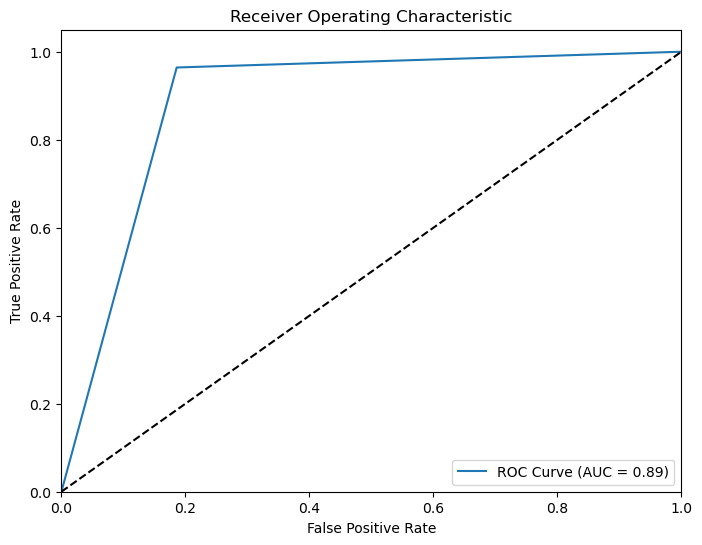

In [59]:
import numpy as np
from tensorflow import keras
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_curve, roc_auc_score
from sklearn.preprocessing import MinMaxScaler

# Normalize the data
scaler = MinMaxScaler()
x_train_normalized = scaler.fit_transform(x_train)
x_valid_normalized = scaler.transform(x_valid)

# Define the architecture of the ANN
model = keras.Sequential([
    keras.layers.Dense(units=128, activation='relu', input_dim=x_train_normalized.shape[1]),
    keras.layers.Dense(units=64, activation='relu'),
    keras.layers.Dense(units=32, activation='relu'),
    keras.layers.Dense(units=1, activation='sigmoid')
])

# Compile the model
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

# Train the model
model.fit(x_train_normalized, y_train, epochs=100, batch_size=32)

# Make predictions on the validation data
y_pred = model.predict(x_valid_normalized)
y_pred = np.round(y_pred).flatten()

# Calculate performance metrics
accuracy = accuracy_score(y_valid, y_pred)
precision = precision_score(y_valid, y_pred)
recall = recall_score(y_valid, y_pred)
f1 = f1_score(y_valid, y_pred)
roc_auc = roc_auc_score(y_valid, y_pred)

# Print performance metrics
print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)
print("F1 Score:", f1)
print("ROC AUC Score:", roc_auc)

# Plot ROC curve
fpr, tpr, thresholds = roc_curve(y_valid, y_pred)
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, label='ROC Curve (AUC = %0.2f)' % roc_auc)
plt.plot([0, 1], [0, 1], 'k--')  # Plot the random guessing curve
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic')
plt.legend(loc='lower right')
plt.show()


In [55]:
from sklearn.model_selection import RandomizedSearchCV
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from xgboost import XGBClassifier
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

The model has an accuracy score of 0.93. That is, in the validation set, the model correctly predicted 92 percent of the columns.

In [51]:
import pandas as pd

# Create an empty DataFrame
metrics_df = pd.DataFrame(columns=['Model', 'Accuracy', 'Precision', 'Recall'])
# Define the models and their respective hyperparameter grids

models = {
    'Decision Tree': (DecisionTreeClassifier(), {'criterion': ['gini', 'entropy'], 'max_depth': [3, 5, 7, None], 'min_samples_split': [2, 5, 10]}),
    'Random Forest': (RandomForestClassifier(), {'n_estimators': [100, 200,300], 'criterion': ['gini', 'entropy'], 'max_depth': [5, 10, None], 'min_samples_split': [2, 5, 10]}),
    'Logistic Regression': (LogisticRegression(), {'C': [0.1, 1], 'solver': ['liblinear', 'saga'], 'penalty': ['l1', 'l2']}),
    'XGBoost': (XGBClassifier(), {'learning_rate': [0.1, 0.05, 0.01], 'max_depth': [3, 5, 7], 'n_estimators': [100, 200,300], 'subsample': [0.6, 0.8, 1.0], 'colsample_bytree': [0.6, 0.8, 1.0]}),

    'Gradient Boosting': (GradientBoostingClassifier(), {'learning_rate': [0.1, 0.05, 0.01], 'n_estimators': [100, 200,300], 'max_depth': [3, 5, 7]}),
    'SVM': (SVC(), {'C': [0.1, 1], 'kernel': ['linear', 'rbf']}),
    'K-Nearest Neighbors': (KNeighborsClassifier(), {'n_neighbors': [3, 5, 7], 'weights': ['uniform', 'distance']}),
}

# Iterate over each model and perform hyperparameter tuning
for model_name, (model, param_grid) in models.items():
    print(f"Training {model_name}...")
    random_search = RandomizedSearchCV(model, param_grid, cv=3, scoring='accuracy', n_iter=50, random_state=5, verbose=2)
    random_search.fit(x_train, y_train)

    # Get the best parameters and the best score
    best_params = random_search.best_params_
    best_score = random_search.best_score_

    print(f"Best parameters for {model_name}: {best_params}")
    print(f"Best score for {model_name}: {best_score}")

    # Evaluate the model on the validation set
    y_pred = random_search.predict(x_valid)
    accuracy = accuracy_score(y_valid, y_pred)
    precision = precision_score(y_valid, y_pred)
    recall = recall_score(y_valid, y_pred)

    # Append metrics to the DataFrame
    metrics_df = metrics_df.append({'Model': model_name, 'Accuracy': accuracy, 'Precision': precision, 'Recall': recall}, ignore_index=True)

    print(f"Accuracy for {model_name}: {accuracy}")
    print(f"Precision for {model_name}: {precision}")
    print(f"Recall for {model_name}: {recall}")
    print("--------------------------------------------")

Training Decision Tree...
Fitting 3 folds for each of 24 candidates, totalling 72 fits
[CV] END ...criterion=gini, max_depth=3, min_samples_split=2; total time=   0.0s
[CV] END ...criterion=gini, max_depth=3, min_samples_split=2; total time=   0.0s
[CV] END ...criterion=gini, max_depth=3, min_samples_split=2; total time=   0.0s
[CV] END ...criterion=gini, max_depth=3, min_samples_split=5; total time=   0.0s
[CV] END ...criterion=gini, max_depth=3, min_samples_split=5; total time=   0.0s
[CV] END ...criterion=gini, max_depth=3, min_samples_split=5; total time=   0.0s
[CV] END ..criterion=gini, max_depth=3, min_samples_split=10; total time=   0.0s
[CV] END ..criterion=gini, max_depth=3, min_samples_split=10; total time=   0.0s
[CV] END ..criterion=gini, max_depth=3, min_samples_split=10; total time=   0.0s
[CV] END ...criterion=gini, max_depth=5, min_samples_split=2; total time=   0.0s
[CV] END ...criterion=gini, max_depth=5, min_samples_split=2; total time=   0.0s
[CV] END ...criterion=

KeyboardInterrupt: 

In [62]:
metrics_df

,Model,Accuracy,Precision,Recall
0,Decision Tree,0.967341,0.938956,1.000000
1,Random Forest,0.978759,0.959432,1.000000
2,Logistic Regression,0.726615,0.720261,0.745211
3,XGBoost,0.890706,0.840107,0.966352
4,Gradient Boosting,0.908008,0.858387,0.978263
5,SVM,0.712605,0.700046,0.748685


In [52]:
metrics_df

,Model,Accuracy,Precision,Recall
0,Decision Tree,0.966793,0.937995,1.000000
1,Random Forest,0.978809,0.959524,1.000000
2,Logistic Regression,0.726615,0.720261,0.745211
3,XGBoost,0.902872,0.852765,0.974988
4,Gradient Boosting,0.908057,0.858462,0.978263
5,SVM,0.712605,0.700046,0.748685
6,K-Nearest Neighbors,0.932688,0.882240,0.999404


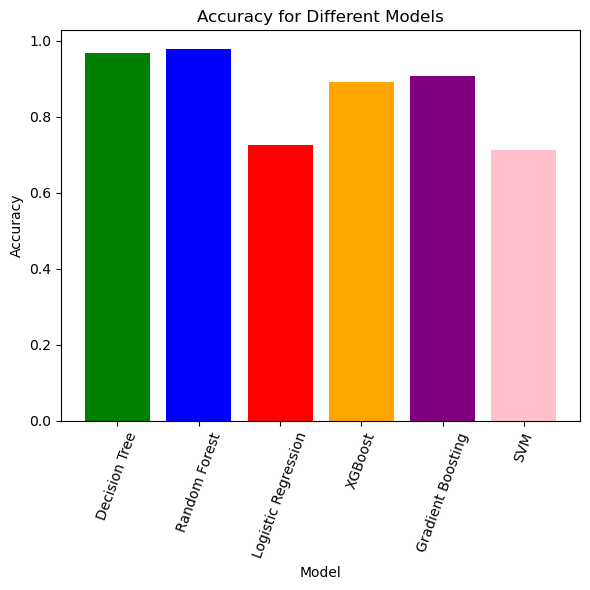

In [63]:
# Sample data
models = metrics_df['Model']
accuracy = metrics_df['Accuracy']
colors = ['green', 'blue', 'red', 'orange', 'purple', 'pink', 'yellow'] 
# Plot the accuracy values
plt.figure(figsize=(6, 6))
plt.bar(models, accuracy, color=colors)
plt.xlabel('Model')
plt.ylabel('Accuracy')
plt.title('Accuracy for Different Models')
plt.xticks(rotation=70)
plt.tight_layout()
plt.show()

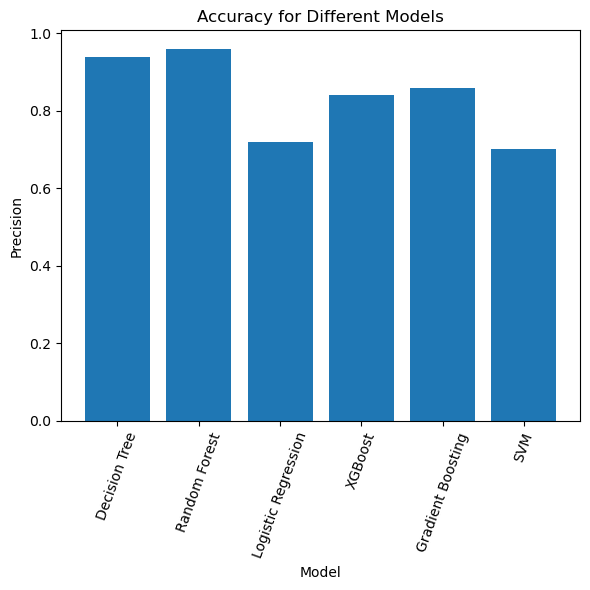

In [64]:
# Plot the accuracy values
plt.figure(figsize=(6, 6))
plt.bar(metrics_df['Model'], metrics_df['Precision'])
plt.xlabel('Model')
plt.ylabel('Precision')
plt.title('Accuracy for Different Models')
plt.xticks(rotation=70)
plt.tight_layout()
plt.show()

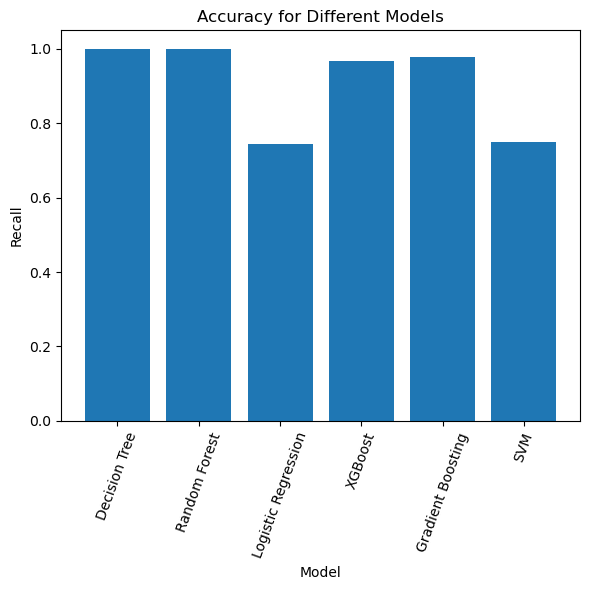

In [65]:
# Plot the accuracy values
plt.figure(figsize=(6, 6))
plt.bar(metrics_df['Model'], metrics_df['Recall'])
plt.xlabel('Model')
plt.ylabel('Recall')
plt.title('Accuracy for Different Models')
plt.xticks(rotation=70)
plt.tight_layout()
plt.show()

In [66]:
from sklearn.metrics import roc_auc_score, roc_curve

# MODEL EXPLAINABILITY
SHAP values (SHapley Additive exPlanations) is a method based on cooperative game theory and used to increase transparency and interpretability of machine learning models.

SHAP values interpret the impact of having a certain value for a given feature in comparison to the prediction we'd make if that feature took some baseline value. SHAP shows the contribution or the importance of each feature on the prediction of the model  but it does not evaluate the quality of the prediction itself.

We are going to check the shap value using shap library. The library takes long to compute and given that we have a large validation set, we only use a random sample from the validation set. 

In [68]:
# Let's pick 1,000 random samples from our validation set
x_sample = x_train.sample(200)

In [69]:
%%time 

#Fits the explainer
explainer = shap.Explainer(model.predict, x_sample)
# Calculates the SHAP values - It takes some time
shap_values = explainer(x_sample)

Permutation explainer: 201it [02:15,  1.37it/s]                                                                        

CPU times: total: 2min 3s
Wall time: 2min 15s


It took 20 minutes 48 seconds of CPU time to calculate the SHAP value of the 1,000  random sample. Imagine how long it would have taken for the whole validation set.

## Force Plot
The force plot is shows the effect each feature has on the prediction, for a given observation. In this plot the positive SHAP values are displayed on the left side and the negative on the right side, as if competing against each other. The highlighted value is the prediction for that observation.

In [70]:
shap.initjs()
shap.plots.force(shap_values[0])

We predicted 1, whereas the base_value is 0.62. Feature values causing increased predictions are in pink, and their visual size shows the magnitude of the feature's effect. Feature values decreasing the prediction are in blue. The biggest impact comes from `department` being 7. `avg_training_score` being 63 has the second highest impact on the prediction at value 63. The two variablesincreased the prediction.  On the other hand, `sum_metric` and `length_of_service` has the third greatest effect and the highest negative effect on the the prediction.

## Waterfall Plot
The waterfall plot has the same information, represented in a different manner.Waterfall plots are designed to display explanations for individual predictions, so they expect a single row of an Explanation object as input. The bottom of a waterfall plot starts as the expected value of the model output, and then each row shows how the positive (red) or negative (blue) contribution of each feature moves the value from the expected model output over the background dataset to the model output for this prediction Here we can see how the sum of all the SHAP values equals the difference between the prediction f(x) and the expected value E[f(x)].

The waterplot below uses the same example as the forceplot to give more detail on the impact of the different features on this particular sample. 

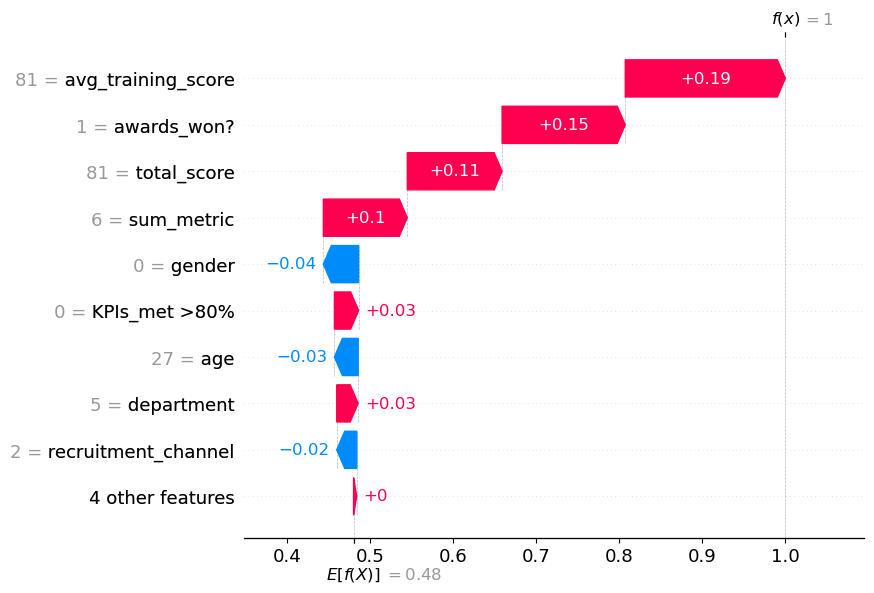

In [71]:
shap.plots.waterfall(shap_values[0])

Note that by default SHAP explains Random Forest classifer models in terms of their margin output, before the logistic link function. That means the units on the x-axis are log-odds units, so negative values imply probabilies of less than 0.5 that the person is promoted. The gray text before the feature names shows the value of each feature for this sample.

In our case, `department` increases the person prediction probability by 0.42. The `avg_training_score` increases the thre prediction probability of being promoted by 0.14. `total_score` has the least positive effect of 0.02. `sum_metric` and `length_of_service` has an equal negative effect of 0.05 on the predicted probability of being promoted. `age` and recruitment channel has a negative effect of 0.04 and 0.02 respectively on the predicted probability of being promoted. 

## Beeswarm Plot
The beeswarm plot is designed to display an information-dense summary of how the top features in a dataset impact the model’s output. Variables that have higher values in the right hand side shows that the higher values of the variable increases the probabibilty of predicting promotion in the data sample.

Note that, the beeswarm is a global plot in the sense that it does not only show the impact of the feature for a given row but for the the random sample of predictions we selected earlier.

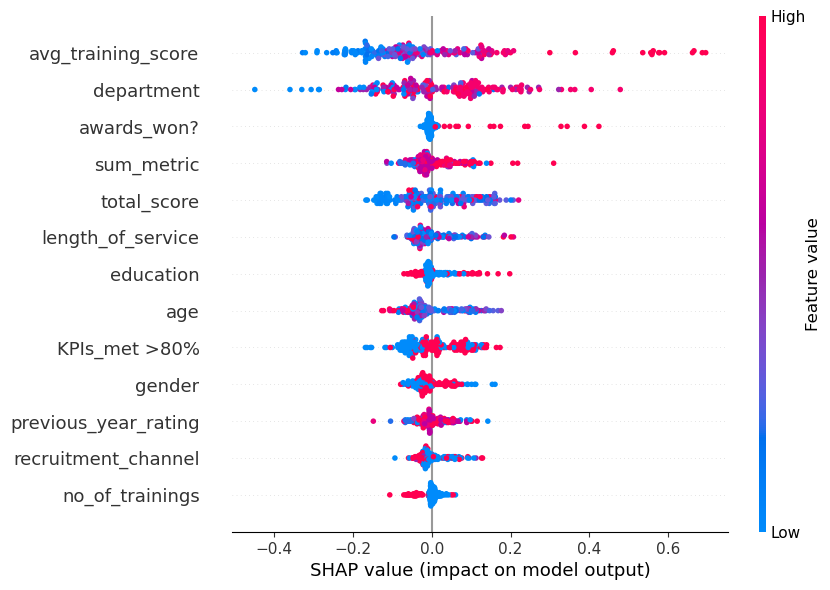

In [72]:
shap.plots.beeswarm(shap_values, order=shap_values.abs.max(0), max_display=20)

This plot is made of many dots. Each dot has three characteristics:

* Vertical location shows what feature it is depicting
* Color shows whether that feature was high or low for that row of the dataset
* Horizontal location shows whether the effect of that value caused a higher or lower prediction.


For example, the jumbling of the pink and red dot of the `department` suggests that sometimes increasing that feature leads to higher predictions, and other times it leads to a lower prediction. Said another way, both high and low values of the feature can have both positive and negative effects on the prediction. Higher values for `awards_won?` leads to higher prediction of promotion. 

`avg_training_score` has a jumbling effect only foe high scores. That is, most fo the employees with low training score has a very low training score has very low probability of being promoted but sometimes, they are promoted nonetheless. But all employees with high training score has a very high probabilityy of being promoted.

Higher values for `awards_won?` leads to higher prediction of promotion. This is because the `award_won?` is an indicator of the perceived productivity of the employee by employers. Remeber the `award_won` column is a categorical column used which has a value of 0 if the employee has not won any award and otherwise 1. That is, no awrd has little effect on probability of being promoted. 



## Global Barplot 
Here the features are ordered from the highest to the lowest effect on the prediction. It takes in account the absolute SHAP value, so it does not matter if the feature affects the prediction in a positive or negative way.This plot shows us what are the main features affecting the prediction of a single observation, and the magnitude of the SHAP value for each feature.

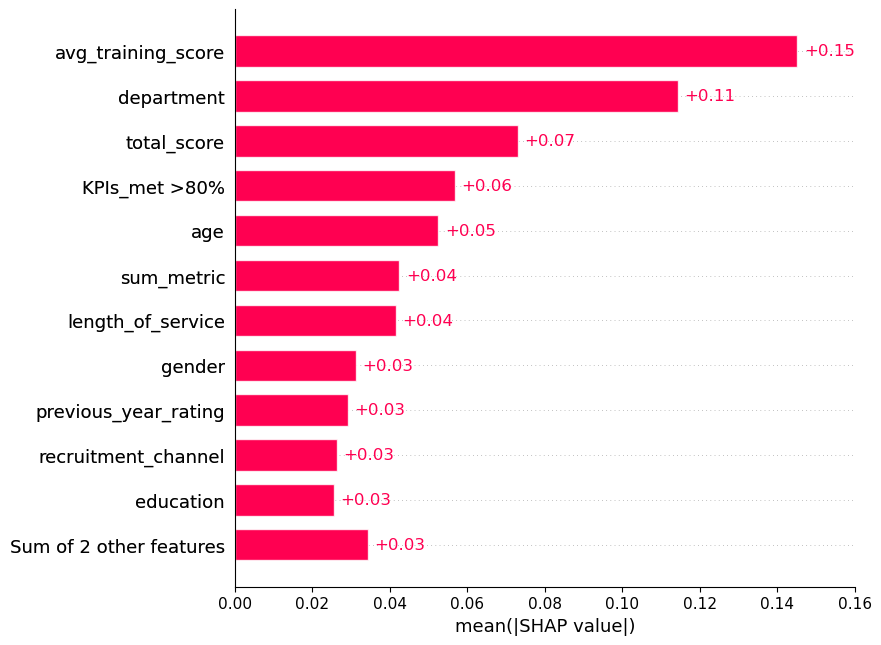

In [73]:
shap.plots.bar(shap_values, max_display=12)

`avg_training_score` has the highest absolute value SHAP values. That is, it has the highest effect on the prediction of promotion. This can be interpreted to mean that employees. ability to learn plays a role in promotion. 
The `department` of the employee plays a large role in predicting promotion. This can be because the department the employee is assigned to depends on course studied and specialization. There are some skills neccessary for higher position in a firm.

`total_score` has the  third highest contribution to the prediction for the same reason as `avg_training_score`.

`age` also has a high effect on the predicted probability of being promoted. This is beca

`no_of_trainings` has the lowest absolute shap value. This is because number of training says noting about the employee's productivity.

## Cohort Bar Plot
The Cohort bar plot shows the contribution of each feature based on a given condition, in our cas, we show the SHAP values for the two genders.

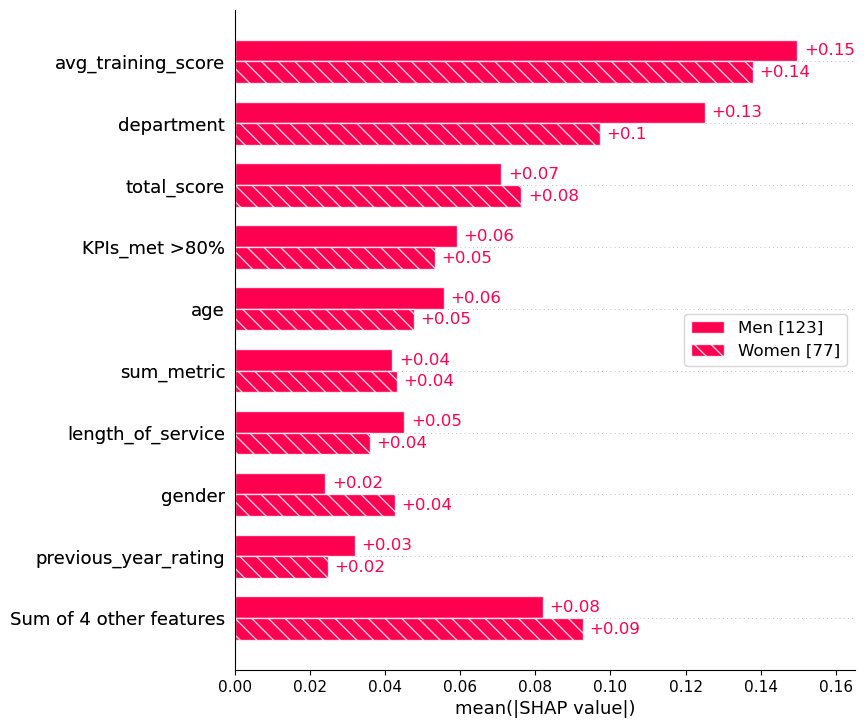

In [74]:
sex = ["Women" if shap_values[i,"gender"].data == 0 else "Men" for i in range(shap_values.shape[0])]
shap.plots.bar(shap_values.cohorts(sex).abs.mean(0))

The plain bar shows the avarage SHAP value for male while the shaded bar shows the same for female. Above you can see that most of the features have higher shap values for male than female samples  with the exception of `recruitment_channel`, `age` and  `total_score` where the features have equal effect on the prediction across the various genders.

# KEY FINDINGS


**1.What are the most important features and the influence these features have in predicting employee promotion with a particular row of data?**
To answer this, we use the force plot and the waterfall plot. For the first row of the sample, the most important features were departemnt which increased predicted probability by 0.42. This was followed by `avg_training_score` which affected the predicted probability by 0.14. The third most important features were `sum_metric` and `length_of_service` which has a negative SHAP value of 0.05. That is, if this particular sample wants to improve the probability of being promoted, effortd should be made to switch department, increase preparation for training test and increase visibility.

**2. Which features are the strongest in predicting employee promotion?**
To answer this, we use the global bar plot. The top 5 important features in predicting employee promotion are: `avg_training_score`, `department`, `total_score`, `age`, and `sum_metric`. They contribute to predicting employee promotion in that order.


**3. Does the contribution of each feature vary by gender?**
For this we use the cohort plot. The plain bar shows the avarage SHAP value for male while the shaded bar shows the same for female. Above you can see that most of the features have higher shap values for male than female samples  with the exception of `recruitment_channel`, `age` and  `total_score` where the features have equal effect on the prediction across the various genders.

# CONCLUSION

This notebook aimed at predictig employee promotion given some features. The analysis covers from data cleaning to exploration to model training and evaluation before going to the most important part neccessary for answering the questions introduced at the beginning, model explainability/interpretation. The result revaled that `avg_training_score`, `department`, `total_score`, `age` and `sum_metric` has the highest impact on predicting employee promotion. The result also showed that the effct of the prediction varies with gender.

If you have any question or contribution or question, be sure to share in the comment section. Also remember to leave an upvote if you found this helpful in order to help others discover the notebook. Thank you!